In [1]:
import pandas as pd
import numpy as np
from datetime import datetime
import plotly.express as px
import plotly.graph_objects as go

In [2]:
pcpr_df = pd.read_csv('../data/pcpr/crimes2016-2020.csv')

pcpr_df['PANDEMIA'] = pcpr_df['data_fato'].apply(lambda x: 1*(datetime.strptime(x,'%Y-%m-%d').date() >= datetime.strptime('11/04/2020','%d/%m/%Y').date()))

pcpr_df.head()

,data_fato,qtde_boletins,tipo,PANDEMIA
0,2016-01-01,18,Estelionato,0
1,2016-01-01,1,Tráfico de drogas,0
2,2016-01-01,114,Furto/Roubo,0
3,2016-01-01,57,Violência Doméstica,0
4,2016-01-02,7,Tráfico de drogas,0


In [3]:
from statsmodels.regression.linear_model import OLS

In [4]:
teste = pcpr_df.groupby(['data_fato','PANDEMIA']).sum().reset_index()

In [5]:
teste['LAG1'] = teste['qtde_boletins'].shift(1).fillna(0)
teste['LAG2'] = teste['qtde_boletins'].shift(2).fillna(0)
teste['LAG3'] = teste['qtde_boletins'].shift(3).fillna(0)
teste['LAG4'] = teste['qtde_boletins'].shift(4).fillna(0)
teste['TEMPO'] = np.arange(teste.shape[0])

In [6]:
X, y = teste[['TEMPO','LAG1','LAG2','PANDEMIA']], teste['qtde_boletins']

model = OLS(y, X).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:          qtde_boletins   R-squared (uncentered):                   0.952
Model:                            OLS   Adj. R-squared (uncentered):              0.952
Method:                 Least Squares   F-statistic:                              9089.
Date:                Mon, 17 Oct 2022   Prob (F-statistic):                        0.00
Time:                        15:49:45   Log-Likelihood:                         -10061.
No. Observations:                1827   AIC:                                  2.013e+04
Df Residuals:                    1823   BIC:                                  2.015e+04
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
TEMPO          0.0168      0.003      5.738      0.000       0.011       0.022
LAG1           0.7449      0.023     32.362      0.000       0.700       0.790
LAG2           0.1876      0.023      8.140      0.000       0.142       0.233
PANDEMIA     -12.5890      4.980     -2.528      0.012     -22.356      -2.822
==============================================================================
Omnibus:                       48.256   Durbin-Watson:                   2.092
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               51.475
Skew:                           0.399   Prob(JB):                     6.64e-12
Kurtosis:                       3.195   Cond. No.                     3.93e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 3.93e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [7]:
df_results = pd.DataFrame([y, model.predict(X)]).transpose()
df_results['Data'] = teste['data_fato']
df_results.rename(columns={'Unnamed 0':'PREVISTAS', 'qtde_boletins':'ATENDIDAS'},inplace=True)
df_results.drop([0],inplace=True)
px.line(df_results,x='Data',y=df_results.columns)

In [8]:
df_results['ERRO'] = df_results['PREVISTAS'] - df_results['ATENDIDAS']
df_results['Z-SCORE'] = (df_results['ERRO'] - df_results['ERRO'].mean())/df_results['ERRO'].std()
df_results['OUTLIER'] = df_results['Z-SCORE'].apply(lambda x: 1*(abs(x) >= 2.17))

In [9]:
fig1 = px.line(df_results, x='Data', y=['ATENDIDAS','PREVISTAS'])
fig1.data[0].line.color = 'rgba(135, 148, 168, .85)'
fig1.data[1].line.color = 'rgba(75, 83, 94, 1)'

fig2 = px.scatter(df_results[df_results['OUTLIER'] == 1], x='Data', y='ATENDIDAS', color_discrete_sequence=['rgba(75, 83, 94, 1)'])
fig2['data'][0]['showlegend'] = True
fig2['data'][0]['name'] = 'Outlier'

fig3 = go.Figure(data=fig1.data + fig2.data)
fig3.show()

In [10]:
pcpr_df.groupby(['tipo']).sum().reset_index().rename(columns={'tipo':'Natureza', 'qtde_boletins':'Ocorrências'}).sort_values(by="Ocorrências",ascending=False)

,Natureza,Ocorrências,PANDEMIA
1,Furto/Roubo,334541,265
3,Violência Doméstica,77960,265
0,Estelionato,51524,265
2,Tráfico de drogas,23308,265


## LISA/Moran

In [11]:
# Graphics
import matplotlib.pyplot as plt
import seaborn
from pysal.viz import splot
from splot.esda import plot_moran

# Analysis
import geopandas as gpd
from pysal.explore import esda
from pysal.lib import weights
from numpy.random import seed

/home/radek/TCC/venv/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning:

The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.

/home/radek/TCC/venv/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning:

The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.



In [16]:
pcpr_bairros = pd.read_csv('../data/pcpr/crimes2016-2020_bairro.csv')

In [30]:
ref = pcpr_bairros.groupby(['descBairro']).sum().reset_index().set_index('descBairro')

dem = pd.read_csv('../data/renda.csv')
dem = dem[['Bairros','População Total']].set_index('Bairros')
ref = ref.join(dem)
ref = ref[~ref['População Total'].isna()]

ref.dropna(inplace=True)
ref['OCORRENCIAS_ATENDIDAS_PER_CAPITA'] = ref['qtde_boletins'] / ref['População Total']
ref.drop(columns=['qtde_boletins','População Total'],inplace=True)
ref.sort_values(by='OCORRENCIAS_ATENDIDAS_PER_CAPITA')

,OCORRENCIAS_ATENDIDAS_PER_CAPITA
descBairro,
CIDADE INDUSTRIAL DE CURITIBA,0.000083
SAO MIGUEL,0.022806
AUGUSTA,0.105059
VISTA ALEGRE,0.129305
CASCATINHA,0.130519
...,...
CAMPO DE SANTANA,0.687662
CENTRO CIVICO,0.776589
SAO FRANCISCO,0.794250


In [31]:
bairros = gpd.read_file('../data/divisa_bairros_cleaned.geojson').set_index('NOME')
bairros.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 75 entries, AGUA VERDE to SANTA FELICIDADE
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    75 non-null     int64   
 1   CODIGO      75 non-null     int64   
 2   TIPO        75 non-null     object  
 3   FONTE       75 non-null     object  
 4   CD_REGIONA  75 non-null     int64   
 5   NM_REGIONA  75 non-null     object  
 6   SHAPE_AREA  75 non-null     float64 
 7   SHAPE_LEN   75 non-null     float64 
 8   geometry    75 non-null     geometry
dtypes: float64(2), geometry(1), int64(3), object(3)
memory usage: 5.9+ KB


In [33]:
db = gpd.GeoDataFrame(bairros.join(ref[["OCORRENCIAS_ATENDIDAS_PER_CAPITA"]]), crs=bairros.crs).to_crs(epsg=3857)[["OCORRENCIAS_ATENDIDAS_PER_CAPITA", "geometry"]].dropna()
db

,OCORRENCIAS_ATENDIDAS_PER_CAPITA,geometry
NOME,,
AGUA VERDE,0.295151,"POLYGON ((-5484832.641 -2931491.254, -5484833...."
JARDIM SOCIAL,0.237798,"POLYGON ((-5480252.197 -2926985.265, -5480258...."
XAXIM,0.185917,"POLYGON ((-5484145.981 -2935829.003, -5484148...."
JARDIM DAS AMERICAS,0.336245,"POLYGON ((-5480008.382 -2933834.210, -5480007...."
GUAIRA,0.289529,"POLYGON ((-5486089.564 -2934441.648, -5486063...."
...,...,...
SANTO INACIO,0.227596,"POLYGON ((-5490638.725 -2927646.697, -5490639...."
VISTA ALEGRE,0.129305,"POLYGON ((-5488456.296 -2924500.831, -5488501...."
SAO BRAZ,0.178165,"POLYGON ((-5493045.709 -2925482.796, -5493099...."


In [34]:
# Generate W from the GeoDataFrame
w = weights.KNN.from_dataframe(db, k=6)
# Row-standardization
w.transform = "R"

In [35]:
db["Occorencias_per_capita_lag"] = weights.spatial_lag.lag_spatial(w, db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"])

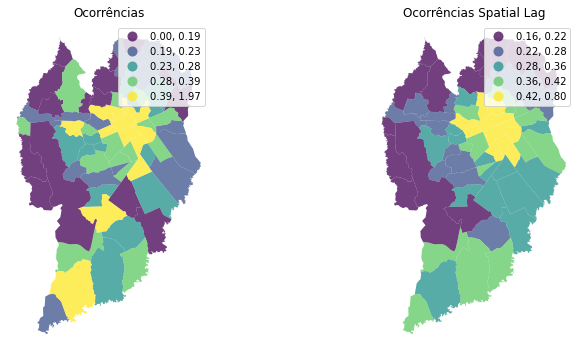

In [36]:
f, axs = plt.subplots(1, 2, figsize=(12, 6))
ax1, ax2 = axs

db.plot(
    column="OCORRENCIAS_ATENDIDAS_PER_CAPITA",
    cmap="viridis",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=ax1,
)
ax1.set_axis_off()
ax1.set_title("Ocorrências")
# contextily.add_basemap(
#     ax1,
#     crs=db.crs,
#     source=contextily.providers.Stamen.TerrainBackground,
# )

db.plot(
    column="Occorencias_per_capita_lag",
    cmap="viridis",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=ax2,
)
ax2.set_axis_off()
ax2.set_title("Ocorrências Spatial Lag")
# contextily.add_basemap(
#     ax2,
#     crs=db.crs,
#     source=contextily.providers.Stamen.TerrainBackground,
# )

plt.show()

In [37]:
db["Ocorrencias_std"] = db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"] - db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"].mean()
db["Ocorrencias_lag_std"] = db["Occorencias_per_capita_lag"] - db["Occorencias_per_capita_lag"].mean()

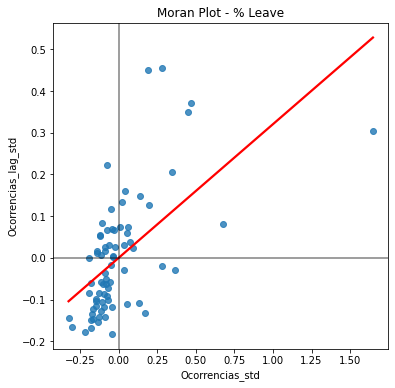

In [38]:
f, ax = plt.subplots(1, figsize=(6, 6))
seaborn.regplot(
    x="Ocorrencias_std",
    y="Ocorrencias_lag_std",
    ci=None,
    data=db,
    line_kws={"color": "r"},
)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Moran Plot - % Leave")
plt.show()

In [39]:
moran = esda.moran.Moran(db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"], w)
print('Moran\'s I: ', moran.I)
print('Moran\'s p: ', moran.p_sim)

Moran's I:  0.3206259550787959
Moran's p:  0.001


In [40]:
lisa = esda.moran.Moran_Local(db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"], w)

In [41]:
spots_labels = {
    0: "Non-Significant",
    1: "HH",
    2: "LH",
    3: "LL",
    4: "HL",
}

db['labels'] = pd.Series(
    # First initialise a Series using values and `db` index
    ((1*(lisa.p_sim < 0.05)) * (lisa.q)),
    index=db.index
    # Then map each value to corresponding label based
    # on the `spots_labels` mapping
).map(spots_labels)

db.reset_index(inplace=True)
db.tail()

,NOME,OCORRENCIAS_ATENDIDAS_PER_CAPITA,geometry,Occorencias_per_capita_lag,Ocorrencias_std,Ocorrencias_lag_std,labels
69,SANTO INACIO,0.227596,"POLYGON ((-5490638.725 -2927646.697, -5490639....",0.256269,-0.096431,-0.085697,Non-Significant
70,VISTA ALEGRE,0.129305,"POLYGON ((-5488456.296 -2924500.831, -5488501....",0.341004,-0.194723,-0.000962,Non-Significant
71,SAO BRAZ,0.178165,"POLYGON ((-5493045.709 -2925482.796, -5493099....",0.238264,-0.145863,-0.103702,Non-Significant
72,CASCATINHA,0.130519,"POLYGON ((-5488683.456 -2925644.261, -5488690....",0.257350,-0.193509,-0.084616,Non-Significant
73,SANTA FELICIDADE,0.279226,"POLYGON ((-5490141.739 -2924318.296, -5490171....",0.159415,-0.044802,-0.182551,LL


In [42]:
db['labels'] = pd.Series(lisa.q,index=db.index).map(spots_labels)
db['labels_sig'] = pd.Series(1*(lisa.p_sim < 0.05)*lisa.q,index=db.index).map(spots_labels)

In [43]:
import json

f = open('../data/divisa_bairros_cleaned.geojson', encoding='utf-8')

bairros_geojson = json.load(f)

In [44]:
fig = px.choropleth_mapbox(db, geojson=bairros_geojson, color="labels",color_discrete_sequence=['red','green','blue','white','yellow'],
                           locations="NOME", featureidkey='properties.NOME',
                           center={"lat": -25.459717, "lon": -49.278820},
                           mapbox_style="carto-positron", zoom=9)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, width=600)
fig.show()

In [45]:
from splot import esda as esdaplot

(<Figure size 929.032x953.642 with 1 Axes>, <AxesSubplot:>)

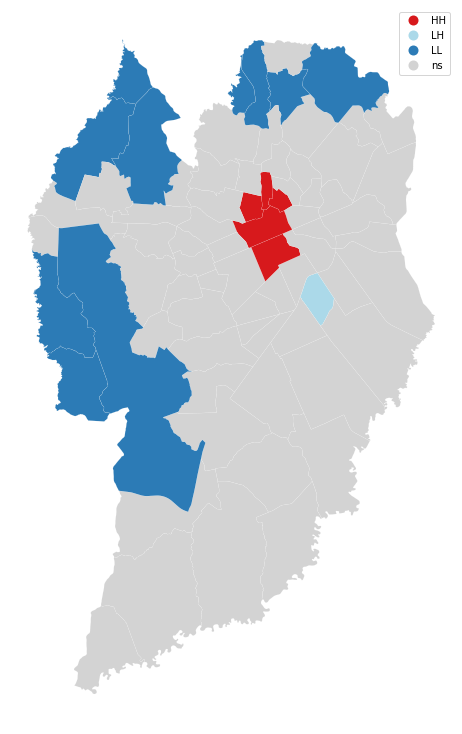

In [46]:
ax = plt.gca()

def set_size(w,h, ax=None):
    """ w, h: width, height in inches """
    if not ax: ax=plt.gca()
    l = ax.figure.subplotpars.left
    r = ax.figure.subplotpars.right
    t = ax.figure.subplotpars.top
    b = ax.figure.subplotpars.bottom
    figw = float(w)/(r-l)
    figh = float(h)/(t-b)
    ax.figure.set_size_inches(figw, figh)

set_size(10,10,ax)

esdaplot.lisa_cluster(lisa, db, p=.05, ax=ax)